In [39]:
import gensim #pip install gensim
import pprint
from gensim import corpora, models
from gensim.models import LdaModel, LdaMulticore
from gensim.models.coherencemodel import CoherenceModel
from nltk.tokenize import word_tokenize
import numpy as np #pip install numpy
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
import logging
import pyLDAvis.gensim #pip install pyLDAvis
import pyLDAvis.gensim_models
import time
from prettytable import PrettyTable, ALL #pip install PrettyTable


In [40]:
source = './doc/cleaned.csv'
df = pd.read_csv(source)

#Tokenizzazione
tweets = df['lemmatized_text'].apply(lambda text: word_tokenize(text))

#Other useful variables
clear_text = df['text']
username = df['username']
time = df['date']
lemmatized_text = df['lemmatized_text']

# Create a dictionary
dictionary = corpora.Dictionary(tweets)

# Create a corpus
corpus = [dictionary.doc2bow(doc) for doc in tweets]

# Train the TF-IDF model
tfidf = models.TfidfModel(corpus)

# Transform the corpus into TF-IDF vectors
tfidf_corpus = tfidf[corpus]

In [41]:
model = LdaModel.load("models/lda_model_8_150_v2")

In [42]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(model, tfidf_corpus, dictionary )
pyLDAvis.display(vis)

In [43]:
for i in range(0,8):
    topic_words = model.show_topic(i, topn=30)
    print(i," word: ",topic_words)

0  word:  [('american', 0.006846046), ('care', 0.0057797907), ('family', 0.0051575145), ('cost', 0.0051478045), ('act', 0.004966737), ('health', 0.0048181005), ('inflation', 0.0044798884), ('working', 0.004423916), ('year', 0.0043954), ('tax', 0.004366815), ('bill', 0.004148352), ('republican', 0.0041099875), ('job', 0.003982184), ('debt', 0.00392319), ('million', 0.0037518346), ('need', 0.0036503514), ('biden', 0.0036261084), ('child', 0.0035794105), ('people', 0.0034979023), ('president', 0.0034796633), ('price', 0.0033716406), ('cut', 0.0033577073), ('economy', 0.0033195221), ('veteran', 0.003241861), ('pay', 0.0032068717), ('work', 0.0030946024), ('gun', 0.003051858), ('democrat', 0.0030069111), ('drug', 0.0029669397), ('time', 0.0029599927)]
1  word:  [('people', 0.004264876), ('war', 0.0042125075), ('ukraine', 0.0039125886), ('israel', 0.0038651435), ('party', 0.003327691), ('america', 0.0027856329), ('biden', 0.0027288338), ('china', 0.0027253923), ('hate', 0.002675154), ('think

In [44]:
name_topic = {
    0: "American/economics/health",
    1: "War",
    2: "News/radio/livestream",
    3: "Republicans vs democrats",
    4: "Border/community/family",
    5: "Election/debate",
    6: "Abortion/rights/guns",
    7: "Infrastructure/job/energy",
}

In [45]:
#Create dataframe to save the results
destination = './doc/results.csv'

#Data
data = {'username': [],
        'date': [],
        'first_topic': [],
        'first_topic_name': [],
        'first_topic_prob': [],
        'second_topic': [],
        'second_topic_name': [],
        'second_topic_prob': [],
        'text': [],
        'lemmatized_text': [],
        }


df1 = pd.DataFrame(data)

#topic_distributions = [model.get_document_topics(doc) for doc in corpus]
topic_distributions2 = [model.get_document_topics(doc, per_word_topics=True) for doc in corpus]

In [46]:
tot_for_topic = {0:0, 1:0, 2:0, 3:0, 4:0, 5:0, 6:0, 7:0} #Conteggio topic
# Initialize an empty dictionary to store document-topic assignments
document_topic_dict = {}

# Iterate through the topic distributions for each document
for i in range(0,len(topic_distributions2)):
    prob_doc = topic_distributions2[i][0]
    prob_doc = sorted(prob_doc, key=lambda x: x[1], reverse=True) #Lista ordinata
    #print("\n\nprob:", prob_doc)
    
    #Inizialize dictionary for the current topic
    document_topic_dict[i] = {}
    
    #get results
    max_topic = prob_doc[0][0]
    max_prob_topic = prob_doc[0][1]
    if len(prob_doc) > 1: 
        second_max_topic = prob_doc[1][0]
        second_prob_topic = prob_doc[1][1]
    else:
        second_max_topic = None
        second_prob_topic = None
    
    # Store the results
    document_topic_dict[i]['first_topic'] = max_topic
    document_topic_dict[i]['first_prob'] = max_prob_topic
    document_topic_dict[i]['second_topic'] = second_max_topic
    document_topic_dict[i]['second_prob'] = second_prob_topic
    
    #print("valori: ", document_topic_dict[i]['first_topic'], document_topic_dict[i]['first_prob'], document_topic_dict[i]['second_topic'], document_topic_dict[i]['second_prob'] )
    
    #Add topic to the totale
    tot_for_topic[max_topic] += 1
    
    #add result to dataframe
    data['username'].append(username[i])
    data['date'].append(time[i])
    data['first_topic'].append(max_topic+1) #topic from 1 to 8
    data['first_topic_name'].append(name_topic[max_topic])
    data['first_topic_prob'].append(max_prob_topic)
    if second_max_topic is not None:
        data['second_topic'].append(second_max_topic+1)
        data['second_topic_name'].append(name_topic[second_max_topic])
        data['second_topic_prob'].append(second_prob_topic)
    else:
        data['second_topic'].append('')
        data['second_topic_name'].append('')
        data['second_topic_prob'].append('')
    data['text'].append(clear_text[i])
    data['lemmatized_text'].append(lemmatized_text[i])

#Save dataframe

#df['second_topic'] = df['second_topic'].apply(lambda x: int(x) if isinstance(x, (int, float)) else x)
df1 = pd.DataFrame(data)
df1 = df1.sort_values(by='first_topic')
df1.to_csv(destination, index=False, header=True)

In [47]:
print(corpus[0])
print(tweets[0])
print(topic_distributions2[1])

[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1), (8, 1), (9, 1), (10, 1), (11, 1), (12, 1), (13, 1), (14, 1), (15, 1), (16, 1), (17, 3), (18, 3), (19, 1), (20, 1), (21, 1), (22, 1), (23, 1), (24, 1), (25, 1), (26, 1), (27, 1), (28, 1), (29, 1), (30, 1), (31, 1), (32, 3), (33, 2), (34, 1), (35, 1)]
['conducted', 'nuclear', 'test', 'nevada', 'hour', 'russia', 'revoked', 'ban', 'atomic', 'weapon', 'testing', 'bloomberg', 'report', 'test', 'radioisotope', 'chemical', 'validate', 'predictive', 'explosion', 'model', 'test', 'come', 'putin', 'seen', 'beijing', 'officer', 'allegedly', 'carrying', 'nuclear', 'briefcase', 'rarely', 'filmed', 'reuters', 'nevada', 'nuclear', 'testing', 'decade', 'specifically', 'nevada', 'national', 'security', 'site', 'established']
([(3, 0.14456081), (4, 0.7918875), (5, 0.05125902)], [(8, [4, 3, 5]), (36, [4, 3, 5]), (37, [4]), (38, [4, 3, 5]), (39, [4, 3, 5]), (40, [4, 3, 5]), (41, [4, 3, 5]), (42, [4]), (43, [5]), (44, [3, 4, 5]), (45, [4, 3, 5

In [48]:
# Print the document-topic assignments
for document, topic in document_topic_dict.items():
    first_topic = topic['first_topic']
    first_prob = format(topic['first_prob'], '.3f')  # Format the probability with 3 decimal places
    second_topic = topic['second_topic']
    if second_topic is not None:
        second_prob = format(topic['second_prob'], '.3f')
        
    
    # Print the document and both the highest and second-highest probability topics
    print(f"\nDoc. {document + 1} has Topic {first_topic +1}({name_topic[first_topic]}) with prob {first_prob}: {clear_text[document]}")
    
    if second_topic is not None:
        print(f"   Second-Highest Topic {second_topic + 1}({name_topic[second_topic]}) with prob {second_prob}")


Doc. 1 has Topic 2(War) with prob 0.425: JUST IN: The U.S. has conducted a nuclear test in Nevada, hours after Russia revoked their ban on atomic weapons testing. Bloomberg reports that the test used radioisotopes and chemicals to “validate new predictive explosion models” The test comes after Putin was seen in Beijing next to his officers who were allegedly carrying his “nuclear briefcase,” something that is very rarely filmed (Reuters). Nevada has been used for nuclear testing for decades, specifically the Nevada National Security Site which was established in 1951.
   Second-Highest Topic 4(Republicans vs democrats) with prob 0.205

Doc. 2 has Topic 5(Border/community/family) with prob 0.792: JUST IN: As United States military bases are currently under attack overseas, Biden compares the current situation to World War 2 and relates it to "democracy." World War 3 here we come. "You know, just as in World War 2, today patriotic American workers are building the arsenal of Democracy a


Doc. 36973 has Topic 6(Election/debate) with prob 0.903: Looking forward to being in the great state of Mississippi today for the @msbookfest! Watch LIVE at 3:45PM ET: https://t.co/lQDJJ9Mllu
   Second-Highest Topic 5(Border/community/family) with prob 0.014

Doc. 36974 has Topic 6(Election/debate) with prob 0.825: My new episode of @RuthlessPodcast is OUT NOW! Thanks for having me on, @ComfortablySmug, @HolmesJosh, @MichaelDuncan, and @JohnAshbrook! 🇺🇸 Listen here: https://t.co/cby0nyWsrO https://t.co/QeGRmqMxgN
   Second-Highest Topic 8(Infrastructure/job/energy) with prob 0.025

Doc. 36975 has Topic 4(Republicans vs democrats) with prob 0.780: Mike Pence Pledges to 'Clean House' at the Justice Department https://t.co/c8r3Zc3PrS
   Second-Highest Topic 8(Infrastructure/job/energy) with prob 0.126

Doc. 36976 has Topic 4(Republicans vs democrats) with prob 0.530: 'I’d Have Sent an Aircraft Carrier': Pence Slams Biden Response to Chinese Spy Balloon https://t.co/siwCzsF6Ma
   Second-H

{0: 15245, 1: 4455, 2: 405, 3: 16000, 4: 9410, 5: 13321, 6: 3837, 7: 7327}
Totale esempi usati: 70000


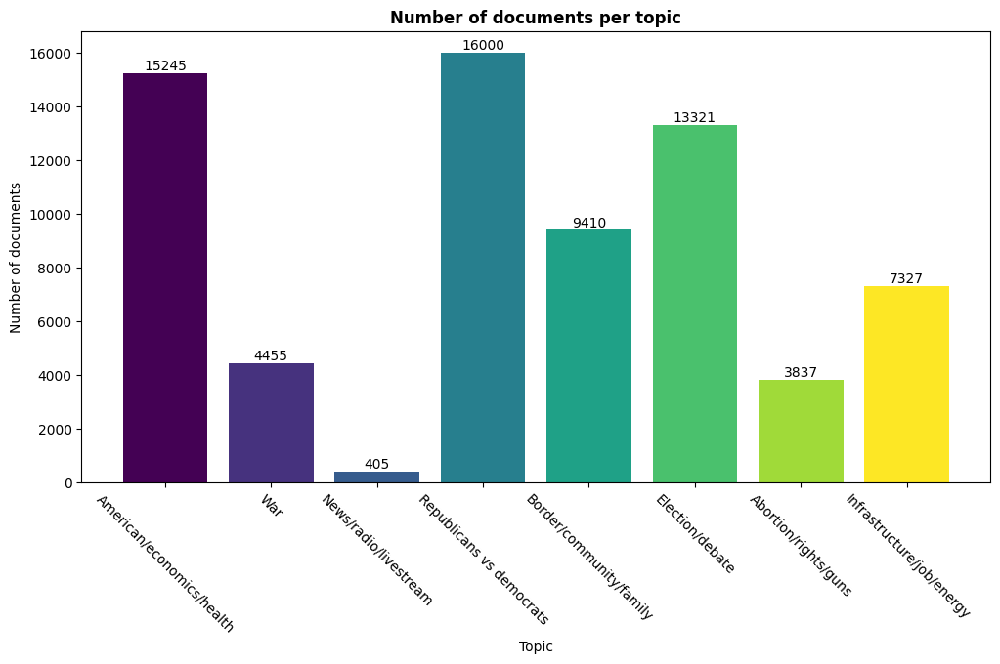

In [49]:
print(tot_for_topic)
print("Totale esempi usati:", sum(tot_for_topic.values()))

colors = plt.colormaps['viridis'](np.linspace(0, 1, 8))

#Plot del numero di documenti per topic
value_x = list(name_topic.values())
value_y = list(tot_for_topic.values())

fig, axes = plt.subplots(figsize=(12,6))
bars = plt.bar(value_x,value_y, align='center', color=colors)
plt.title("Number of documents per topic", fontweight='bold')
plt.xlabel("Topic")
plt.ylabel("Number of documents")
plt.xticks(rotation=-45)
# Annotate bars with their values
for bar, y_value in zip(bars, value_y):
    plt.text(bar.get_x() + bar.get_width() / 2, y_value, str(y_value), ha='center', va='bottom')
